In [1]:
%load_ext autoreload
%autoreload 2

import pickle
import os
import numpy as np
import cv2
import time
import sys
import re
from copy import deepcopy
from collections import defaultdict
from itertools import islice
from tqdm import tqdm_notebook
from time import time
from easydict import EasyDict
from IPython.core.debugger import set_trace
from matplotlib import pyplot as plt
from warnings import filterwarnings

import torch
from torch import nn
import torch.nn.functional as F
from torch import autograd
from torch.utils.data import DataLoader
from torch.utils.data import DataLoader

from mvn.datasets.human36m import Human36MMultiViewDataset
from mvn.utils.img import image_batch_to_numpy, denormalize_image,to_numpy
from mvn.utils.multiview import project_3d_points_to_image_plane_without_distortion
from mvn.utils.vis import draw_2d_pose
from mvn.utils import img, multiview, volumetric, op, vis, misc, cfg
from mvn.datasets import utils as dataset_utils

from train_decomposition import setup_human36m_dataloaders

CONNECTIVITY_DICT = {
    'cmu': [(0, 2), (0, 9), (1, 0), (1, 17), (2, 12), (3, 0), (4, 3), (5, 4), (6, 2), (7, 6), (8, 7), (9, 10), (10, 11), (12, 13), (13, 14), (15, 1), (16, 15), (17, 18)],
    'coco': [(0, 1), (0, 2), (1, 3), (2, 4), (5, 7), (7, 9), (6, 8), (8, 10), (11, 13), (13, 15), (12, 14), (14, 16), (5, 6), (5, 11), (6, 12), (11, 12)],
    "mpii": [(0, 1), (1, 2), (2, 6), (5, 4), (4, 3), (3, 6), (6, 7), (7, 8), (8, 9), (8, 12), (8, 13), (10, 11), (11, 12), (13, 14), (14, 15)],
    "human36m": [(0, 1), (1, 2), (2, 6), (5, 4), (4, 3), (3, 6), (6, 7), (7, 8), (8, 16), (9, 16), (8, 12), (11, 12), (10, 11), (8, 13), (13, 14), (14, 15)],
    "kth": [(0, 1), (1, 2), (5, 4), (4, 3), (6, 7), (7, 8), (11, 10), (10, 9), (2, 3), (3, 9), (2, 8), (9, 12), (8, 12), (12, 13)],
}

%matplotlib inline

retval = {
    'subject_names': ['S1', 'S5', 'S6', 'S7', 'S8', 'S9', 'S11'],
    'camera_names': ['54138969', '55011271', '58860488', '60457274'],
    'action_names': [
        'Directions-1', 'Directions-2',
        'Discussion-1', 'Discussion-2',
        'Eating-1', 'Eating-2',
        'Greeting-1', 'Greeting-2',
        'Phoning-1', 'Phoning-2',
        'Posing-1', 'Posing-2',
        'Purchases-1', 'Purchases-2',
        'Sitting-1', 'Sitting-2',
        'SittingDown-1', 'SittingDown-2',
        'Smoking-1', 'Smoking-2',
        'TakingPhoto-1', 'TakingPhoto-2',
        'Waiting-1', 'Waiting-2',
        'Walking-1', 'Walking-2',
        'WalkingDog-1', 'WalkingDog-2',
        'WalkingTogether-1', 'WalkingTogether-2']
}

CHANNELS_LIST = [16, 32, 32, 32, 32, 32, 32, 32, 32, 32, 64, 64, 64, 64, 64, 128, 128, 128, 128, 128,\
                                  128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128,\
                                  128, 128, 128, 128, 128, 64, 64, 64, 32, 32, 32, 32, 32]

device = 'cuda:0' #torch.cuda.current_device()

torch.backends.cudnn.benchmark = True
torch.backends.cudnn.enabled = True

# Calculate

In [2]:
config_path = './experiments/human36m/train/human36m_vol_baseline.yaml'
config = cfg.load_config(config_path)
num_joints = config.model.backbone.num_joints

In [3]:
train_loader, val_loader, _ = setup_human36m_dataloaders(config, is_train=True, distributed_train=False)

for batch in train_loader:
    images_batch, keypoints_3d_gt, keypoints_3d_validity_gt, proj_matricies_batch = dataset_utils.prepare_batch(batch, device)
    break

In [4]:
keypoints_3d = train_loader.dataset.labels['table']['keypoints']
N_train = keypoints_3d.shape[0]

In [5]:
from sklearn.decomposition import PCA, KernelPCA
from sklearn.preprocessing import StandardScaler
from tensorly.decomposition import tucker

In [6]:
pca = PCA()
scaler = StandardScaler()
X = keypoints_3d.reshape(N_train, -1)
X_scaled = scaler.fit_transform(X)
pca.fit(X_scaled)

PCA(copy=True, iterated_power='auto', n_components=None, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

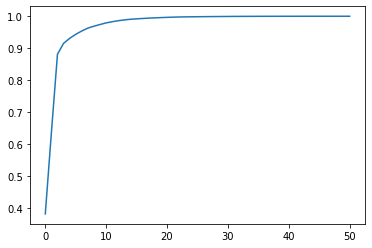

In [7]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))

# Visualize

In [28]:
keypoints_pca_unscaled = scaler.inverse_transform(pca.components_.reshape(51,-1))#.reshape(-1,17,3)

In [31]:
torch.save(torch.tensor(keypoints_pca_unscaled), './basis/3dkeypoints_pca')

In [30]:
ls -la ./basis

total 998808
drwxrwxr-x  2 ibulygin ibulygin      4096 окт.   8 22:52 ./
drwxrwxr-x 16 ibulygin ibulygin      4096 окт.   9 13:28 ../
-rw-rw-r--  1 ibulygin ibulygin 113639787 окт.   8 18:35 heatmaps32_3d_euclidean_convgauss_var0.5_kernel5
-rw-rw-r--  1 ibulygin ibulygin 909115757 окт.   8 22:52 heatmaps64_3d_euclidean_convgauss_var0.5_kernel5


In [9]:
# keypoints = keypoints_pca_unscaled[batch_index]
# keypoints.shape

In [67]:
X = torch.randn(4,256,32,32,32)
X_avg = torch.nn.AdaptiveMaxPool3d((1,1,1))(X).squeeze(-1).squeeze(-1).squeeze(-1)

In [68]:
X_avg_2 = X.view(4,256,-1).max(-1)[0]

In [69]:
(X_avg == X_avg_2).all()

tensor(True)

In [11]:
VOLUME_SIZE = 32
coord_volumes, _, base_points = op.get_coord_volumes(kind=train_loader.dataset.kind,
                                                        training=False,
                                                        rotation=False,
                                                        cuboid_side=2500,
                                                        volume_size=VOLUME_SIZE,
                                                        device='cuda:0',
                                                        keypoints=keypoints_pca_unscaled,
                                                        batch_size=None,
                                                        dt=None,
                                                        )

In [14]:
import plotly.graph_objects as go
import numpy as np
import colorlover as cl

def display_pose(coord_volumes, keypoints=None, heatmap_3d=None):
    '''
    coord_volumes - 
    keypoints - 
    heatmap_3d - 
    '''
    
    X = coord_volumes[...,0]
    Y = coord_volumes[...,1]
    Z = coord_volumes[...,2]

    color_kp = cl.scales['10']['div']['RdYlBu'][-1]
    plotly_data = []
    # connections
    if keypoints is not None:
        connectivity = CONNECTIVITY_DICT['human36m']
        for (index_from, index_to) in connectivity:
            xs, ys, zs = [np.array([keypoints[index_from, j], keypoints[index_to, j]]) for j in range(3)]
            plotly_data.append(go.Scatter3d(x=xs, y=ys, z=zs,
                                 marker=dict(size=6,color='red',opacity=0.1),
                                 line=dict(color='blue',width=2)))
    
    if heatmap_3d is not None:
        plotly_data.append(go.Volume(
            x=X.flatten(),
            y=Y.flatten(),
            z=Z.flatten(),
            value=heatmap_3d.flatten(),
            flatshading=False,
        #     isomin=0.1,
        #     isomax=0.9,
            opacity=0.1, # needs to be small to see through all surfaces
            surface_count=60 # needs to be a large number for good volume rendering
            ))

    fig = go.Figure(data=plotly_data)
    fig.show()

In [20]:
component_number = 20
display_pose(coord_volumes[component_number].detach().cpu().numpy(),
             keypoints_pca_unscaled[component_number]) # keypoints, 

# Make heatmap

In [47]:
# # H = op.make_3d_heatmap(coord_volumes.cpu(), torch.tensor(keypoints).unsqueeze(0), pow=1)

# coord_volumes = coord_volumes.cpu()
# tri_keypoints_3d = torch.tensor(keypoints).unsqueeze(0)

# coord_volume_unsq = coord_volumes.unsqueeze(1)
# keypoints_gt_i_unsq = tri_keypoints_3d.unsqueeze(2).unsqueeze(2).unsqueeze(2)
# dists = torch.sqrt(((coord_volume_unsq - keypoints_gt_i_unsq) ** 2).sum(-1))
# pow = 1
# EPS = 1e-15
# # H = torch.exp(-dists)
# H = 1./(torch.pow(dists,pow) + EPS)
# H = H / H.view(*H.shape[:2], -1).sum(-1).unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)

In [48]:
# torch.pow(dists,pow).min(), torch.pow(dists,pow).max()

In [49]:
# display_pose(coord_volumes[0].detach().cpu().numpy(), heatmap_3d=H[0].cpu().numpy(), keypoints=keypoints)

In [50]:
# heatmap_3d = H[0].cpu().numpy()
# coord_volumes_numpy = coord_volumes[0].cpu().numpy()

# plotly_data = []
# for j in tqdm_notebook(range(17)):
#     heatmap = heatmap_3d[j]
#     for index, x in np.ndenumerate(heatmap):
#         if x > np.quantile(heatmap.flatten(), 0.99995):
#             xs,ys,zs = coord_volumes_numpy[index]
#             v = x/heatmap.max()
#             plotly_data.append(go.Scatter3d(x=[xs], y=[ys], z=[zs],
#                                          marker=dict(size=6,color='green',opacity=v)))

# connectivity = CONNECTIVITY_DICT['human36m']
# for (index_from, index_to) in connectivity:
#     xs, ys, zs = [np.array([keypoints[index_from, j], keypoints[index_to, j]]) for j in range(3)]
#     plotly_data.append(go.Scatter3d(x=xs, y=ys, z=zs,
#                          marker=dict(size=6,color='red',opacity=0.1),
#                          line=dict(color='blue',width=2)))

In [51]:
# layout = go.Layout(
#     width=1024,
#     height=1024,
#     scene = dict(
#         aspectmode='cube'
# ))
# fig = go.Figure(data=plotly_data, layout=layout)
# fig.show()

# Convolution

In [52]:
coord_volumes = coord_volumes.cpu()
tri_keypoints_3d = torch.tensor(keypoints_pca_unscaled)

coord_volume_unsq = coord_volumes.unsqueeze(1)
keypoints_gt_i_unsq = tri_keypoints_3d.unsqueeze(2).unsqueeze(2).unsqueeze(2)
dists = torch.sqrt(((coord_volume_unsq - keypoints_gt_i_unsq) ** 2).sum(-1))

In [53]:
argmins = dists.view(*dists.shape[:2], -1).argmin(-1)

In [54]:
dists_binary = torch.zeros_like(dists)

In [55]:
for (i,j), indx in tqdm_notebook(np.ndenumerate(argmins)):
    indx = np.unravel_index(indx, dists.shape[-3:])
    dists_binary[i,j][indx] = 1.


In [56]:
dists_binary[0].sum(0).numpy().shape

(64, 64, 64)

In [57]:
display_pose(coord_volumes[0].detach().cpu().numpy(),keypoints_pca_unscaled[0],heatmap_3d=dists_binary[0].sum(0).numpy())#  keypoints, 

## Create heatmaps

In [58]:
k = 3
SIGMA=0.5
covariance = torch.eye(3)*SIGMA
mean = torch.zeros(3)
kernel_size = 5
x = torch.arange(-(kernel_size//2), (kernel_size//2)+1)
grid = torch.stack(torch.meshgrid([x,x,x]), dim=-1).type(torch.float).view(-1,3)

mean_ = mean.unsqueeze(0)
kernel = (1./(torch.sqrt(torch.det(covariance))*(np.sqrt(2*np.pi)**k)))*torch.exp((-1/2)*(((grid - mean_)@torch.inverse(covariance))*(grid - mean_)).sum(-1))
kernel = kernel/kernel.sum()

heatmaps_3d = torch.zeros_like(dists_binary)
kernel = kernel.view(kernel_size,kernel_size,kernel_size).unsqueeze(0).unsqueeze(0)

In [62]:
for j in tqdm_notebook(range(num_joints)):
    heatmaps_3d[:,j:j+1] = F.conv3d(dists_binary[:,j:j+1], weight=kernel, bias=None, padding=kernel_size//2, stride=1)
    
display_pose(coord_volumes[0].detach().cpu().numpy(),keypoints_pca_unscaled[0],heatmap_3d=heatmaps_3d[0].sum(0).numpy())#  keypoints, 

In [70]:
# torch.save(heatmaps_3d, './basis/heatmaps{0}_3d_euclidean_convgauss_var{1}_kernel{2}'.format(VOLUME_SIZE,SIGMA,kernel_size))

# Tucker

In [23]:
from tensorly.decomposition import tucker

In [24]:
%%time
X = np.random.randn(1000,17,32,32,32)
core, factors = tucker(X)

KeyboardInterrupt: 

In [25]:
core.shape

NameError: name 'core' is not defined

In [80]:
for f in factors:
    print(f.shape)

(10, 10)
(17, 17)
(32, 32)
(32, 32)
(32, 32)
